In [4]:
import casadi as ca
import numpy as np
import matplotlib.pyplot as plt

# Define the states
x1 = ca.MX.sym('x1')
x2 = ca.MX.sym('x2')
x  = ca.vertcat(x1, x2)

# Define the controls
u  = ca.MX.sym('u')

# Van der Pol oscillator system (nonlinear ODE)
ode = ca.vertcat(x2, (1-x1**2)*x2-x1+u)

# Create the function
f = ca.Function('f', [x, u], [ode], ['x', 'u'], ['ode'])

# Evaluate the function
print(f(ca.vertcat(0.2, 0.8), 0.1))

# Constants
T = 10  # Time horizon
N = 100  # Number of control intervals

# DAE problem structure

dae = {'x':x, 'p':u, 'ode':ode}

# Integrator options
intg_options = {
    'tf': T/N,
    'simplify': True,
    'number_of_finite_elements': 4
}
# Create the integrator
intg = ca.integrator('intg', 'rk', dae, intg_options)

res = intg(x0=ca.vertcat(0,1), p=0)
print(res['xf'])
res = intg(x0=x, p=u)

# Extract the final state
x_next = res["xf"]
# Simplify API to (x,u)->(x_next)
F = ca.Function('F', [x, u], [x_next], ['x', 'u'], ['x_next'])

# Evaluating the function with given inputs
print(F(ca.vertcat(0, 1), 0))
print(F(ca.vertcat(0.1, 0.9), 0.1))

sim = F.mapaccum(N)

[0.8, 0.668]
[0.104986, 1.09943]
[0.104986, 1.09943]
[0.194411, 0.987648]


[0.104986, 1.09943]
[0.194411, 0.987648]


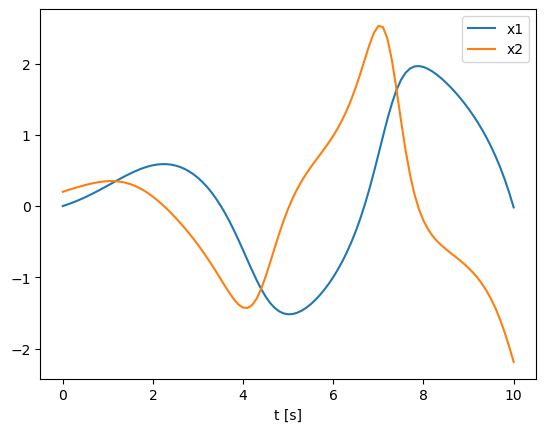

In [5]:

# Evaluating the function with given inputs
print(F(ca.vertcat(0, 1), 0))
print(F(ca.vertcat(0.1, 0.9), 0.1))

sim = F.mapaccum(N)

# Define the initial condition and evaluate the simulation
x0 = ca.vertcat(0, 0.2)
res = sim(x0, np.zeros((1, N)))

# Extract states from result
x1_res = res[0, :].full().flatten()
x2_res = res[1, :].full().flatten()

# Concatenate initial condition
x1_full = np.concatenate(([float(x0[0])], x1_res))
x2_full = np.concatenate(([float(x0[1])], x2_res))

# Plotting
tgrid = np.linspace(0, T, N+1)
plt.figure()
plt.plot(tgrid, x1_full, label='x1')
plt.plot(tgrid, x2_full, label='x2')
plt.legend()
plt.xlabel('t [s]')
plt.show()

In [6]:
opti = ca.Opti()
x = opti.variable(2, N+1)  # Decision variables for state trajectory
u = opti.variable(1, N)
p = opti.parameter(2, 1)  # Parameter (not optimized over)
tube_radius = opti.parameter()
opti.set_value(tube_radius, 0.2)  # Set an appropriate value

objective = ca.sum1(ca.sum2(x**2)) + ca.sum1(ca.sum2(u**2))
opti.minimize(objective)

for k in range(N):
    # Dynamics difference equation
    opti.subject_to(x[:, k+1] == F(x[:, k], u[:, k]))
    # Tube constraint
    opti.subject_to(ca.sumsqr(x[:, k] - p) <= tube_radius**2)
   
# Constraints
for i in range(N):
    opti.subject_to(u[:, i] >= -1) #input constraints lower
    opti.subject_to(u[:, i] <= 1) #input constraints upper
    
    
# Initial condition constraint
opti.subject_to(x[:, 0] == p)

In [7]:
# Choose IPOPT as a solver
solver_opts = {'ipopt': {'print_level': 12, 'tol': 1e-6}}  # for example, to increase print level and set tolerance
opti.solver('ipopt', solver_opts)

# Set a concrete value for p
opti.set_value(p, [0, 0.2])

# Solve the optimization problem
sol = opti.solve()



List of options:

                                    Name   Value                # times used
                           linear_solver = mumps                     2
                             print_level = 12                        2
                                     tol = 1e-06                     2

******************************************************************************
This program contains Ipopt, a library for large-scale nonlinear optimization.
 Ipopt is released as open source code under the Eclipse Public License (EPL).
         For more information visit https://github.com/coin-or/Ipopt
******************************************************************************

This is Ipopt version 3.14.11, running with linear solver MUMPS 5.4.1.

Number of nonzeros in equality constraint Jacobian...:      802
Number of nonzeros in inequality constraint Jacobian.:      400
Number of nonzeros in Lagrangian Hessian.............:      602

Scaling parameter for objective functio

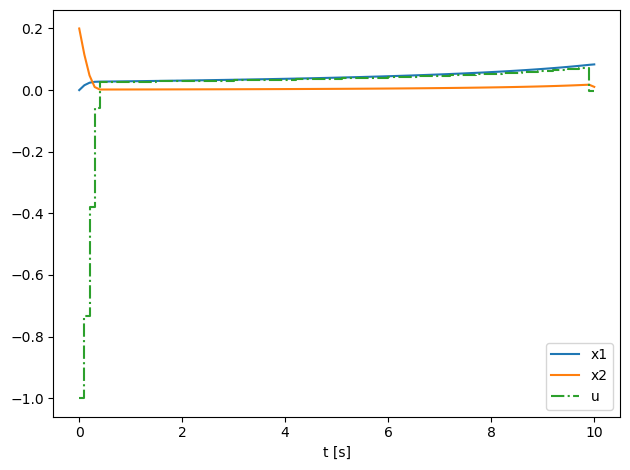

In [8]:

plt.figure()

# Plot state trajectories
plt.plot(tgrid, sol.value(x).T)  # Transpose might be needed depending on shape

# Plot control trajectory
# Adding nan to ensure the same length for stairs plot
u_values = np.append(sol.value(u), np.nan)
plt.step(tgrid, u_values, where='post', linestyle='-.')  # 'stairs' in MATLAB corresponds to 'step' in matplotlib

# Label axes and legend
plt.xlabel('t [s]')
plt.legend(['x1', 'x2', 'u'])

# Display the figure
plt.tight_layout()  # This can help in making the figure "nice", similar to the `nice_fig` function
plt.show()
